<a href="https://colab.research.google.com/github/AakashAhuja30/Deep-Learning/blob/master/CNN_1D_2D.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Problem 1**

In [1]:
# Loading Google Drive

from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [ ]:
#Loading the necessary libaries
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers
from tensorflow.keras import Model
import numpy as np
import librosa
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
import librosa.display
import matplotlib.pyplot as plt
import IPython.display as ipd

from keras.models import Sequential
from keras.layers import Dense, Activation
from keras.layers import Dense, Dropout, Flatten
from keras.layers import  Conv1D,Conv2D, MaxPooling2D,MaxPooling1D
from keras.optimizers import SGD

**Loading the training voice**

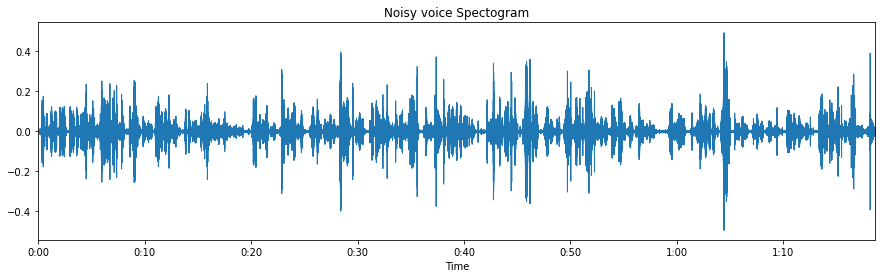

In [ ]:
#Input voice signal-Dirty Signal
sn, sr=librosa.load('/content/drive/My Drive/train_dirty_male.wav', sr=None) 
X=librosa.stft(sn, n_fft=1024, hop_length=512)

#Take magnitude spectrum of dirty signal
x_train=np.transpose(np.abs(X))
plt.figure(figsize=(15,4))
plt.title("Noisy voice Spectogram")
librosa.display.waveplot(sn,sr=sr, max_points=50000.0, x_axis='time', offset=0.0, max_sr=1000)

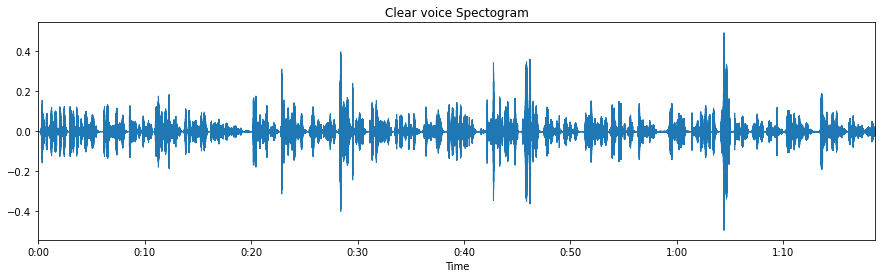

In [ ]:
#Output voice signal-Clean Signal
sc, sr2=librosa.load('/content/drive/My Drive/train_clean_male.wav', sr=None) 
Y=librosa.stft(sc, n_fft=1024, hop_length=512)

#Take magnitude spectrum of clean signal
y_train=np.transpose(np.abs(Y))

plt.figure(figsize=(15,4))
plt.title("Clear voice Spectogram")
librosa.display.waveplot(sc,sr=sr2, max_points=50000.0, x_axis='time', offset=0.0, max_sr=1000)

In [ ]:
#Checking shape of x_train-dirty voice and y_train-clear voice
print(x_train.shape)
print(y_train.shape)

(2459, 513)
(2459, 513)


In [ ]:
#Reshaping x_train since CNN will take one of the row vectors of (513,1) as input
x_train=np.reshape(x_train,(x_train.shape[0],x_train.shape[1],1))
print(x_train.shape)
print(y_train.shape)

(2459, 513, 1)
(2459, 513)


**Creating 1D CNN Model**

In [ ]:
#Instantiating the 1D CNN model
model=Sequential()
model.add(Conv1D(filters=32,kernel_size=2,activation='relu',input_shape=(513,1)))
model.add(MaxPooling1D(pool_size=3,strides=2))
model.add(Flatten())
model.add(Dense(513,activation="relu"))

In [ ]:
model.compile(loss=keras.losses.mean_squared_error,
              optimizer=keras.optimizers.Adam(learning_rate=0.0002),
              metrics=['accuracy'])

In [ ]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_1 (Conv1D)            (None, 512, 32)           96        
_________________________________________________________________
max_pooling1d_1 (MaxPooling1 (None, 255, 32)           0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 8160)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 513)               4186593   
Total params: 4,186,689
Trainable params: 4,186,689
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#Fitting this 1D CNN model with our training data and output data
model.fit(x_train, y_train, epochs=500, batch_size=128,verbose=0)

In [ ]:
model.save('/content/drive/My Drive/model.h5')    

In [ ]:
#using the trained model to predict 
predicted_sound=model.predict(x_train,batch_size=64)
np.shape(predicted_sound)

(2459, 513)

In [ ]:
#Normalizing the output
prediction_complex = np.multiply(np.divide(X,np.abs(X)),predicted_sound.T)
prediction_timedomain = librosa.istft(prediction_complex,hop_length=512, win_length=1024)

In [ ]:
prediction_timedomain.shape

(1258496,)

**Calculating SNR for predicted sound**

In [ ]:
s_clean = sc[0:prediction_timedomain.size]
SNR = 10*np.log10(np.dot(s_clean.T,s_clean)/np.dot((s_clean - prediction_timedomain).T,(s_clean - prediction_timedomain)))
print('SNR:',SNR)

SNR: 16.537494659423828


In [ ]:
librosa.output.write_wav('predicted_cleansignal.wav', prediction_timedomain, sr)

**TRAINING-DIRTY SIGNAL**

In [ ]:
ipd.Audio('/content/drive/My Drive/train_dirty_male.wav')

**DENOISING DIRTY SIGNAL-PREDICTED SIGNAL** 

In [ ]:
ipd.Audio('predicted_cleansignal.wav')

**TESTING THE MODEL ON TEST SIGNALS**

In [ ]:
#Input variable-noisy voice-test
snt, srt=librosa.load('/content/drive/My Drive/test_x_01.wav', sr=None) 
Xt=librosa.stft(snt, n_fft=1024, hop_length=512)
#Taking magnitude of signal and transposing
x_test_abs = np.abs(Xt)
x_test = np.transpose(x_test_abs)
print(x_test.shape)

(142, 513)


In [ ]:
#Reshaping the test signal to input into model
x_test=np.reshape(x_test,(x_test.shape[0],x_test.shape[1],1))
print(x_test.shape)

(142, 513, 1)


In [ ]:
#Predicting using the trained model above on test signal-1
prediction = model.predict(x_test)
print(prediction.shape)

(142, 513)


In [ ]:
#Normalizing the output
prediction_complex = np.multiply(np.divide(Xt,x_test_abs),prediction.T)
prediction_timedomain = librosa.istft(prediction_complex,hop_length=512, win_length=1024)
print(prediction_timedomain.shape)

(72192,)


In [ ]:
librosa.output.write_wav('test_reconstructed.wav', prediction_timedomain, srt)

**ACTUAL TEST SIGNAL**

In [ ]:
ipd.Audio('/content/drive/My Drive/test_x_01.wav')

**DENOISED TEST SIGNAL using 1D CNN**

In [ ]:
ipd.Audio('test_reconstructed.wav')

**TEST SIGNAL 2**

In [ ]:
#Input variable-noisy voice-test
snt, srt=librosa.load('/content/drive/My Drive/test_x_02.wav', sr=None) 
Xt=librosa.stft(snt, n_fft=1024, hop_length=512)
#Taking magnitude of signal and transposing
x_test_abs = np.abs(Xt)
x_test = np.transpose(x_test_abs)
print(x_test.shape)

(380, 513)


In [ ]:
x_test=np.reshape(x_test,(x_test.shape[0],x_test.shape[1],1))
print(x_test.shape)

(380, 513, 1)


In [ ]:
prediction = model.predict(x_test)
print(prediction.shape)

(380, 513)


In [ ]:
#Normalizing the output
prediction_complex = np.multiply(np.divide(Xt,x_test_abs),prediction.T)
prediction_timedomain = librosa.istft(prediction_complex,hop_length=512, win_length=1024)
print(prediction_timedomain.shape)
librosa.output.write_wav('test_reconstructed_02.wav', prediction_timedomain, srt)

(194048,)


**ACTUAL TEST SIGNAL**

In [ ]:
ipd.Audio('/content/drive/My Drive/test_x_02.wav')

**DENOISED SIGNAL USING 1D CNN**

In [ ]:
ipd.Audio('test_reconstructed_02.wav')

**Problem 2**

In [1]:
#Loading the necessary libraries
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers
from tensorflow.keras import Model
import numpy as np
import librosa
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
import librosa.display
import matplotlib.pyplot as plt
import IPython.display as ipd

from keras.models import Sequential
from keras.layers import Dense, Activation
from keras.layers import Dense, Dropout, Flatten
from keras.layers import  Conv1D,Conv2D, MaxPooling2D,MaxPooling1D
from keras.optimizers import SGD

In [2]:
#Input voice signal-Dirty Signal
sn, sr=librosa.load('/content/drive/My Drive/train_dirty_male.wav', sr=None) 
X=librosa.stft(sn, n_fft=1024, hop_length=512)
X_abs=np.abs(X)
#Take magnitude spectrum of dirty signal
x_train=np.transpose(X_abs)

In [3]:
#Output voice signal-Clean Signal
sc, sr2=librosa.load('/content/drive/My Drive/train_clean_male.wav', sr=None) 
S=librosa.stft(sc, n_fft=1024, hop_length=512)

#Take magnitude spectrum of clean signal
y_train=np.transpose(np.abs(S))

In [4]:
print(x_train.shape)
print(y_train.shape)

(2459, 513)
(2459, 513)


**Preparing 2D image data out of spectogram**

In [5]:
def create_Image(data,image_height):
  image_width = data.shape[1]
  number_of_images = data.shape[0] - image_height +1
  output = np.zeros((number_of_images,image_height,image_width))
  for i in range(number_of_images):
    output[i,:,:] = data[i:i+20,:]
  return output

In [8]:
image_height = 20 #Given

# Define input image data
X_train = create_Image(x_train,image_height)
print('Shape of Train data:',X_train.shape)

Y_train = y_train[19:,:]
print('Shape of Train label is:',Y_train.shape)

Shape of Train data: (2440, 20, 513)
Shape of Train label is: (2440, 513)


In [9]:
#Reshaping test data to add channel
X_train = X_train.reshape(-1,20,513,1)
print(X_train.shape)

(2440, 20, 513, 1)


In [33]:
#Defining model for 2D CNN
model1=Sequential()
model1.add(Conv2D(filters=8,kernel_size=(4,4),activation="relu",input_shape=(20,513,1),padding='same',
                  kernel_initializer='he_normal'))
model1.add(Conv2D(filters=16,kernel_size=(2,2),activation="elu",padding='same',
                  kernel_initializer='he_normal'))
model1.add(MaxPooling2D(pool_size=(2,2),strides=2,padding='same'))
model1.add(Conv2D(filters=32,kernel_size=(1,1),activation="elu",padding='same',
                  kernel_initializer='he_normal'))
model1.add(MaxPooling2D(pool_size=(2,2),strides=2,padding='same'))
model1.add(Flatten())
model1.add(Dense(1024,activation="relu",kernel_initializer='he_normal'))
model1.add(Dense(513,activation="relu",kernel_initializer='he_normal'))

In [34]:
model1.compile(loss=keras.losses.mean_squared_error,
              optimizer=keras.optimizers.Adam(learning_rate=0.0002),
              metrics=['accuracy'])

In [35]:
model1.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_5 (Conv2D)            (None, 20, 513, 8)        136       
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 20, 513, 16)       528       
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 10, 257, 16)       0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 10, 257, 32)       544       
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 5, 129, 32)        0         
_________________________________________________________________
flatten_3 (Flatten)          (None, 20640)             0         
_________________________________________________________________
dense_6 (Dense)              (None, 1024)             

In [36]:
#Using some of the training data as validation data
model1.fit(X_train[0:2239,:,:], Y_train[0:2239,:],
           epochs=500, batch_size=64,
           validation_data=(X_train[2240:2440,:,:], Y_train[2240:2440,:]))

Epoch 498/500
35/35 [==============================] - 1s 20ms/step - loss: 0.0025 - accuracy: 0.7695 - val_loss: 0.0155 - val_accuracy: 0.2250
Epoch 499/500
35/35 [==============================] - 1s 20ms/step - loss: 0.0025 - accuracy: 0.7544 - val_loss: 0.0155 - val_accuracy: 0.2200
Epoch 500/500
35/35 [==============================] - 1s 20ms/step - loss: 0.0025 - accuracy: 0.7508 - val_loss: 0.0155 - val_accuracy: 0.2150


In [37]:
model1.save("/content/drive/My Drive/model1.h5")

In [38]:
#Using the 2D CNN to denoise training data and using the predictions to calculate SNR
prediction= model1.predict(X_train)
print(prediction.shape)

(2440, 513)


In [39]:
def augment_prediction(input):
  augmented_mat = np.random.rand(19,513)/1000
  return np.vstack((augmented_mat,input))


In [40]:
augmented_prediction = augment_prediction(prediction)
prediction_complex = np.multiply(np.divide(X,X_abs),augmented_prediction.T)
prediction_timedomain = librosa.istft(prediction_complex,hop_length=512, win_length=1024)

In [42]:
s_clean = sc[0:prediction_timedomain.size]
SNR = 10*np.log10(np.dot(s_clean.T,s_clean)/np.dot((s_clean - prediction_timedomain).T,(s_clean - prediction_timedomain)))
SNR

13.713933229446411

In [43]:
librosa.output.write_wav('predicted_cleansignal.wav', prediction_timedomain, sr)

**Original Signal**

In [21]:
ipd.Audio('/content/drive/My Drive/train_dirty_male.wav')

**Denoised training signal using 2D CNN**

In [44]:
ipd.Audio('predicted_cleansignal.wav')

**Test signal 1**

In [47]:
#Input variable-noisy voice-test
snt, srt=librosa.load('/content/drive/My Drive/test_x_01.wav', sr=None) 
Xt=librosa.stft(snt, n_fft=1024, hop_length=512)
#Taking magnitude of signal and transposing
x_test_abs = np.abs(Xt)
x_test = np.transpose(x_test_abs)

print(x_test.shape)

X_test = create_Image(x_test,20)
print('Shape of Test data:',X_test.shape)

X_test = X_test.reshape(-1,20,513,1)
print(X_test.shape)

prediction= model1.predict(X_test)
print(prediction.shape)

augmented_prediction = augment_prediction(prediction)
print(augmented_prediction.shape)
prediction_complex = np.multiply(np.divide(Xt,x_test_abs),augmented_prediction.T)
prediction_timedomain = librosa.istft(prediction_complex,hop_length=512,win_length=1024)
print(prediction_timedomain.shape)
librosa.output.write_wav('predicted_cleansignaltest1.wav', prediction_timedomain, srt)

(142, 513)
Shape of Test data: (123, 20, 513)
(123, 20, 513, 1)
(123, 513)
(142, 513)
(72192,)


**Original Signal**

In [52]:
ipd.Audio('/content/drive/My Drive/test_x_01.wav')

**Recovered Signal**

In [48]:
ipd.Audio('predicted_cleansignaltest1.wav')

**Test Signal 2**

In [49]:
#Input variable-noisy voice-test
snt, srt=librosa.load('/content/drive/My Drive/test_x_02.wav', sr=None) 
Xt=librosa.stft(snt, n_fft=1024, hop_length=512)
#Taking magnitude of signal and transposing
x_test_abs = np.abs(Xt)
x_test = np.transpose(x_test_abs)

print(x_test.shape)

X_test = create_Image(x_test,20)
print('Shape of Test data:',X_test.shape)

X_test = X_test.reshape(-1,20,513,1)
print(X_test.shape)

prediction= model1.predict(X_test)
print(prediction.shape)

augmented_prediction = augment_prediction(prediction)
print(augmented_prediction.shape)
prediction_complex = np.multiply(np.divide(Xt,x_test_abs),augmented_prediction.T)
prediction_timedomain = librosa.istft(prediction_complex,hop_length=512,win_length=1024)
print(prediction_timedomain.shape)
librosa.output.write_wav('predicted_cleansignaltest2.wav', prediction_timedomain, srt)

(380, 513)
Shape of Test data: (361, 20, 513)
(361, 20, 513, 1)
(361, 513)
(380, 513)
(194048,)


**Original Signal**

In [51]:
ipd.Audio('/content/drive/My Drive/test_x_02.wav')

**Recovered Signal**

In [50]:
ipd.Audio('predicted_cleansignaltest2.wav')